In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import numpy as np
import matplotlib.pyplot as plt

import Equations as eq
import plot_conf as cplot

from scipy.interpolate import interp1d
from scipy.integrate import solve_ivp, quad

In [3]:
cplot.general()

In [4]:
def find_nearest(array, value):
    n = [abs(i-value) for i in array]
    idx = n.index(min(n))

    indtest = list(array).index(max(array))

    if (indtest != len(array)-1) and (idx < indtest):
        array_test = array[indtest::]
        n = [abs(i-value) for i in array_test]
        idx = n.index(min(n))
        # print('-->', array_test[idx])
        idx = idx + (indtest - 1)

    return (array[idx], idx)

In [7]:

# Masa = -4*np.pi*g1
mases_Val = [38.18822635170187]

# Example 1
beta = 1000
rmaxI = 500
a0, a1 = 0.01, 2.  # a0, a1 = 0.01, 1.

from scipy.interpolate import interp1d

for mas in mases_Val:
    g1 = mas / (-4 * np.pi)
    argB = [a0, a1, g1, rmaxI]
        
    rspan, sol = eq.NDsolverEGBstars(
            beta, argB, Nptos=700000, rmin=1e-02, rmax=1000,
            met='DOP853', Rtol=1e-14, Atol=1e-14
        ) # sol -> [N, g, phi, dN, dphi] met -> 'DOP853' 'RK45'

    # Compute mass profile
    masaP = 8 * np.pi * eq.masaADMProf(rspan, sol[1])

    # Identifying the m99
    valM, indx = find_nearest(masaP, 0.99*mas)
    R99, M99 = rspan[indx], masaP[indx]
R99, M99, M99 / (8 * np.pi * R99)

/Users/armandoroqueestrada/anaconda3/lib/python3.12/site-packages/scipy/integrate/_ivp/rk.py:505: UserWarning: At least one element of `rtol` is too small. Setting `rtol = np.maximum(rtol, 2.220446049250313e-14)`.
  super().__init__(fun, t0, y0, t_bound, max_step, rtol, atol,


(76.92142875918393, 37.80634557017076, 0.01955588603460079)

(0.0, 106.0)

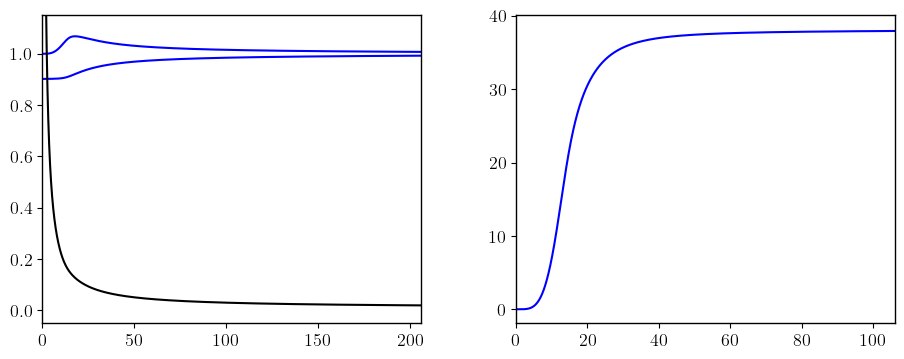

In [8]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(11, 4),
                       sharex=False, sharey=False,
                       gridspec_kw=dict(hspace=0.1, wspace=.25))

ax[0].plot(rspan, sol[0], color='blue')
ax[0].plot(rspan, sol[1], color='blue')
ax[0].plot(rspan, sol[2], color='black')
ax[0].set_xlim(0, 206)
ax[0].set_ylim(-0.05, 1.15)

ax[1].plot(rspan, masaP, label=f'Masa = {mas:.2f} M', color='blue')
ax[1].set_xlim(0, 106)

In [9]:
# Schw.
M = eq.masaADMProf(rspan, sol[1])[-1] # M99/(8 * np.pi)
Sch = lambda r, M: np.sqrt(1 - 2*M/r)
rspan2 = np.linspace(2*M+.1, 4*M*10, 5000)

dNprof = np.gradient(Sch(rspan2, M), rspan2)
metricprofs = [1/Sch(rspan2, M), Sch(rspan2, M), dNprof]  # gprof, Nprof, dNprof

#plt.plot(rspan, metricprofs[0], label='gtt')
#plt.plot(rspan, metricprofs[1], label='grr')
#plt.vlines(x=2*M, ymin=-0.5, ymax=2.5, ls=':', color='k', alpha=0.4)
#plt.xlim(0, 200)
#plt.ylim(0, 5)
#plt.show()

rlim = 6*M
vllim = np.sqrt(2.*M/3.) * rlim/np.sqrt(-4*M+ rlim)
valoresSch = []
lval = np.logspace(np.log10(np.round(vllim, 4)), np.log10(np.round(vllim, 3) + 8), 30)
for l in lval:
    values = [l, 0]  # l, gs
    raiz, ddVeff = eq.ISCO(rspan2, metricprofs, values, phiprofs=None, check=False, zeroAsum=1e-4)
    valoresSch.append((raiz, ddVeff))

raizvaloresSch = np.array([[i, lval[ind]] for ind, v in enumerate(valoresSch) for i in v[0]], dtype=float)
raizddVeffSch = np.array([[i, lval[ind]] for ind, v in enumerate(valoresSch) for i in v[1]], dtype=float)

In [8]:
# 3*38.18822635170187/(4*np.pi), rlim

(0.0, 15.0)

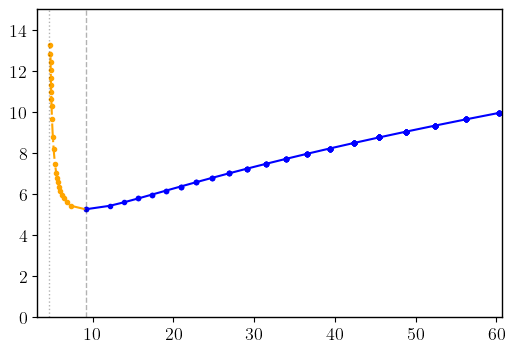

In [9]:
scRL = lambda l, M: (l**2 - np.sqrt(l**4 - 12 * l**2 * M**2))/(2*M)
scRL2 = lambda l, M: (l**2 + np.sqrt(l**4 - 12 * l**2 * M**2))/(2*M)

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(6, 4),
                       sharex=False, sharey=False,
                       gridspec_kw=dict(hspace=0.1, wspace=.25))

for i in range(len(raizvaloresSch[:, 0])):
    ax.plot(raizvaloresSch[i, 0], raizvaloresSch[i, 1], ls='', color='b' if raizddVeffSch[i, 0]>0 else 'orange',
        marker='o', markersize=3, label='Raiz')
ax.plot(scRL(lval, M), lval, ls='-.', c='orange', label='Raiz')
ax.plot(scRL2(lval, M), lval, ls='-', c='b', label='Raiz')
ax.vlines(3*M, ymin=0, ymax=100, ls=':', lw=1, color='k', alpha=0.3)
ax.vlines(6*M, ymin=0, ymax=100, ls='--', lw=1, color='k', alpha=0.3)

ax.set_xlim(rspan2[0], rspan2[-1])
ax.set_ylim(0, 15)

In [10]:
# ISCO

lval2 = np.logspace(-2, np.log10(12), 55) # np.linspace(0.05, 11, 35) #np.logspace(-1, np.log10(12), 20)
metricprofs = [sol[1], sol[0], sol[3]]  # gprof, Nprof, dNprof
phiprofs = [sol[2], sol[4]]  # phiprof, dphiprof

gs_val = [0, 0.02, 0.1, 0.3, 0.4, 0.5] 

valores = [[] for _ in range(len(gs_val))]  # Initialize a list for each gs value
for ind, gs in enumerate(gs_val):
    for l in lval2:
        values = [l, gs]  # l, gs
        raiz, ddVeff = eq.ISCO(rspan, metricprofs, values, phiprofs=phiprofs, check=False, zeroAsum=1e-5, newtonMet=False) #2e-6
        valores[ind].append((gs, l, raiz, ddVeff))

raizvalores = [[] for _ in range(len(gs_val))]
raizddVeff = [[] for _ in range(len(gs_val))]
for ind, valor in enumerate(valores):
    raizvalores[ind] = np.array([[i, v[1]] for v in valor for i in v[2]], dtype=float)
    raizddVeff[ind] = np.array([[i, v[1]] for v in valor for i in v[3]], dtype=float)

/Users/armandoroqueestrada/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:1242: RuntimeWarning: divide by zero encountered in divide
  a = -(dx2)/(dx1 * (dx1 + dx2))
/Users/armandoroqueestrada/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:1243: RuntimeWarning: divide by zero encountered in divide
  b = (dx2 - dx1) / (dx1 * dx2)
/Users/armandoroqueestrada/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:1244: RuntimeWarning: divide by zero encountered in divide
  c = dx1 / (dx2 * (dx1 + dx2))
/Users/armandoroqueestrada/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:1250: RuntimeWarning: invalid value encountered in add
  out[tuple(slice1)] = a * f[tuple(slice2)] + b * f[tuple(slice3)] + c * f[tuple(slice4)]


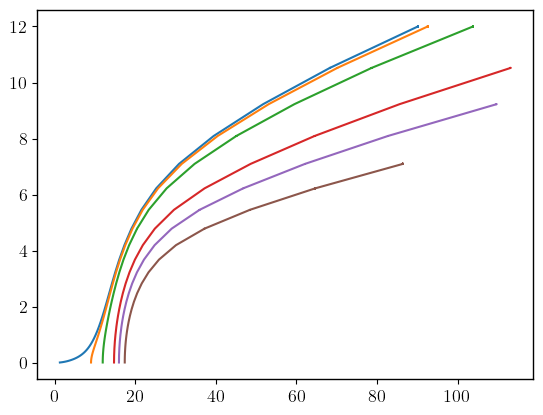

In [11]:
# data
dataFilt = []

i = 0
plt.plot(raizvalores[i][:, 0], raizvalores[i][:, 1])

dataFilt.append([gs_val[i], raizvalores[i][:, 0], raizvalores[i][:, 1], raizddVeff[i][:, 0]])

i = 1
plt.plot(raizvalores[i][:, 0], raizvalores[i][:, 1])

dataFilt.append([gs_val[i], raizvalores[i][:, 0], raizvalores[i][:, 1], raizddVeff[i][:, 0]])

i = 2
plt.plot(raizvalores[i][:, 0], raizvalores[i][:, 1])

dataFilt.append([gs_val[i], raizvalores[i][:, 0], raizvalores[i][:, 1], raizddVeff[i][:, 0]])

i = 3
ind = raizvalores[i][:, 0]<120
plt.plot(raizvalores[i][ind, 0], raizvalores[i][ind, 1])

dataFilt.append([gs_val[i], raizvalores[i][ind, 0], raizvalores[i][ind, 1], raizddVeff[i][ind, 0]])

i = 4
ind = raizvalores[i][:, 0]<140
plt.plot(raizvalores[i][ind, 0], raizvalores[i][ind, 1])

dataFilt.append([gs_val[i], raizvalores[i][ind, 0], raizvalores[i][ind, 1], raizddVeff[i][ind, 0]])

i = 5
ind = raizvalores[i][:, 0]<100
plt.plot(raizvalores[i][ind, 0], raizvalores[i][ind, 1])

dataFilt.append([gs_val[i], raizvalores[i][ind, 0], raizvalores[i][ind, 1], raizddVeff[i][ind, 0]])

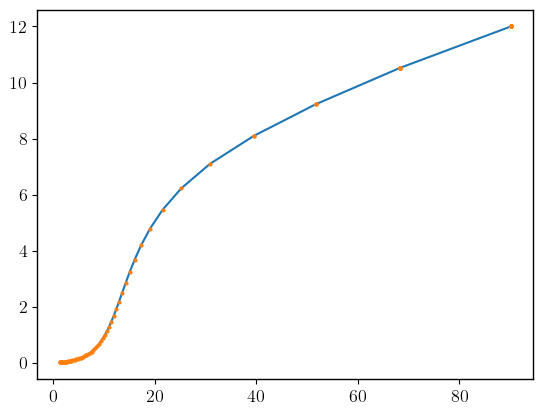

In [23]:
i = 0
ind = raizddVeff[i][:, 0]>0

plt.plot(raizvalores[i][ind, 0], raizddVeff[i][ind, 1])
plt.plot(raizvalores[i][:, 0], raizddVeff[i][:, 1], 'o', markersize=2)

In [269]:
np.savez('DataGBstar.npz', np.array(dataFilt, dtype=object))


In [ ]:
# EKG
# [r, g0, n0, p0, p1]
solKG = np.load('EKGInd8.npz', allow_pickle=True)['arr_0']

In [9]:
fac = 4.0
# Compute mass profile
masaP = 8 * np.pi * eq.masaADMProf(solKG[0], solKG[1])

# Identifying the m99
mas = masaP[-1]
valM, indx = find_nearest(masaP, 0.99*mas)
R99, M99 = rspan[indx], masaP[indx]
R99, M99

(0.059999071427228046, 9.438907349373606)

(0.0, 220.0)

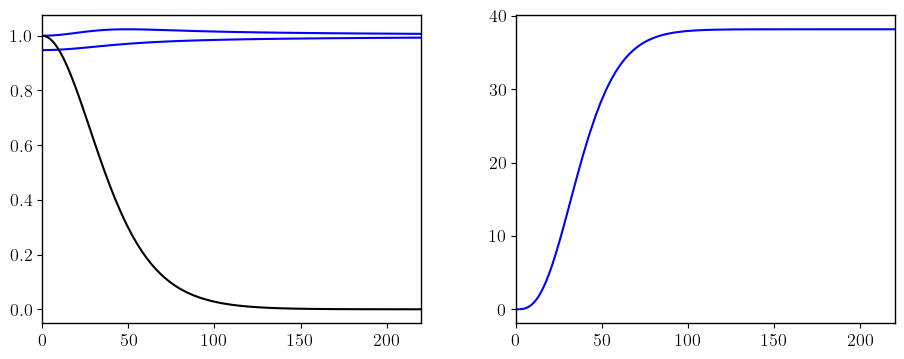

In [10]:
cte = (solKG[1][-1]*solKG[2][-1])

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(11, 4),
                       sharex=False, sharey=False,
                       gridspec_kw=dict(hspace=0.1, wspace=.25))

ax[0].plot(fac * solKG[0], solKG[1], color='blue')
ax[0].plot(fac * solKG[0], solKG[2]/cte, color='blue')
ax[0].plot(fac * solKG[0], solKG[3]/solKG[3][0], color='black')
ax[0].set_xlim(0, 220)
#ax[0].set_ylim(-0.05, 1.15)

ax[1].plot(fac * solKG[0], fac * masaP, label=f'Masa = {mas:.2f} M', color='blue')
ax[1].set_xlim(0, 220)

In [ ]:
## Generando los datos de la EKG con m=\lambda_* Mp /4, para una lectura del campo uno a uno, lambda_* = 2
lval3 = np.logspace(-2, np.log10(12), 55)  # np.linspace(0.01, 12, 55) 

rspan3 = fac * solKG[0]
Nprof = solKG[2]/cte
gprof = solKG[1]
phiprof = solKG[3]
dphiprof = solKG[4]
dNprof = np.gradient(Nprof, rspan3)
metricprofs = [gprof, Nprof, dNprof]  # gprof, Nprof, dNprof
phiprofs = [phiprof, dphiprof]  # phiprof, dphiprof

gs_val = [0, 0.02, 0.1, 0.3, 0.4, 0.5] #0, 0.05, 
valoresEKG = [[] for _ in range(len(gs_val))]  # Initialize a list for each gs value
for ind, gs in enumerate(gs_val):
    for l in lval3:
        values = [l, gs]  # l, gs
        raiz, ddVeff = eq.ISCO(rspan3, metricprofs, values, phiprofs=phiprofs, check=False,
                                tol=1e-14, zeroAsum=1e-4, newtonMet=False) #2e-6
        valoresEKG[ind].append((gs, l, raiz, ddVeff))

raizvaloresEKG = [[] for _ in range(len(gs_val))]
raizddVeffEKG = [[] for _ in range(len(gs_val))]
for ind, valor in enumerate(valoresEKG):
    raizvaloresEKG[ind] = np.array([[i, v[1]] for v in valor for i in v[2]], dtype=float)
    raizddVeffEKG[ind] = np.array([[i, v[1]] for v in valor for i in v[3]], dtype=float)

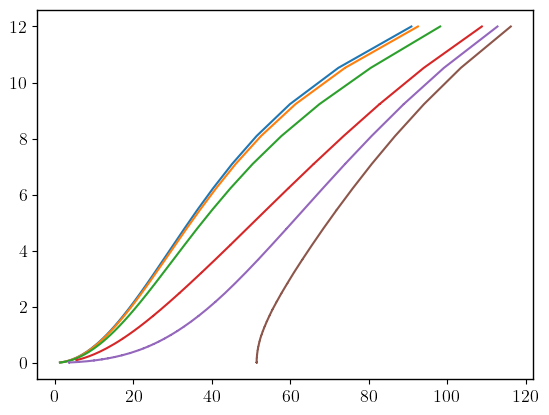

In [193]:
# data
dataFilt = []

i = 0
ind = raizvaloresEKG[0][:, 0]<95
plt.plot(raizvaloresEKG[i][ind, 0], raizvaloresEKG[i][ind, 1])

dataFilt.append([gs_val[i], raizvaloresEKG[i][ind, 0], raizvaloresEKG[i][ind, 1], raizddVeffEKG[i][ind, 0]])

i = 1
plt.plot(raizvaloresEKG[i][:, 0], raizvaloresEKG[i][:, 1])

dataFilt.append([gs_val[i], raizvaloresEKG[i][:, 0], raizvaloresEKG[i][:, 1], raizddVeffEKG[i][:, 0]])

i = 2
ind = raizvaloresEKG[i][:, 0]<100
plt.plot(raizvaloresEKG[i][ind, 0], raizvaloresEKG[i][ind, 1])

dataFilt.append([gs_val[i], raizvaloresEKG[i][ind, 0], raizvaloresEKG[i][ind, 1], raizddVeffEKG[i][ind, 0]])

i = 3
ind = (raizvaloresEKG[i][:, 0]>5) * (raizvaloresEKG[i][:, 1]>=0.09)
plt.plot(raizvaloresEKG[i][ind, 0], raizvaloresEKG[i][ind, 1])

dataFilt.append([gs_val[i], raizvaloresEKG[i][ind, 0], raizvaloresEKG[i][ind, 1], raizddVeffEKG[i][ind, 0]])

i = 4
ind = raizvaloresEKG[i][:, 0]<115
plt.plot(raizvaloresEKG[i][ind, 0], raizvaloresEKG[i][ind, 1])

dataFilt.append([gs_val[i], raizvaloresEKG[i][ind, 0], raizvaloresEKG[i][ind, 1], raizddVeffEKG[i][ind, 0]])

i = 5
ind = raizvaloresEKG[i][:, 0]>40
plt.plot(raizvaloresEKG[i][ind, 0], raizvaloresEKG[i][ind, 1])

dataFilt.append([gs_val[i], raizvaloresEKG[i][ind, 0], raizvaloresEKG[i][ind, 1], raizddVeffEKG[i][ind, 0]])

In [194]:
np.savez('DataEKG.npz', np.array(dataFilt, dtype=object))


In [5]:
DataEKG = np.load('DataEKG.npz', allow_pickle=True)['arr_0']
DataGBstar = np.load('DataGBstar.npz', allow_pickle=True)['arr_0']

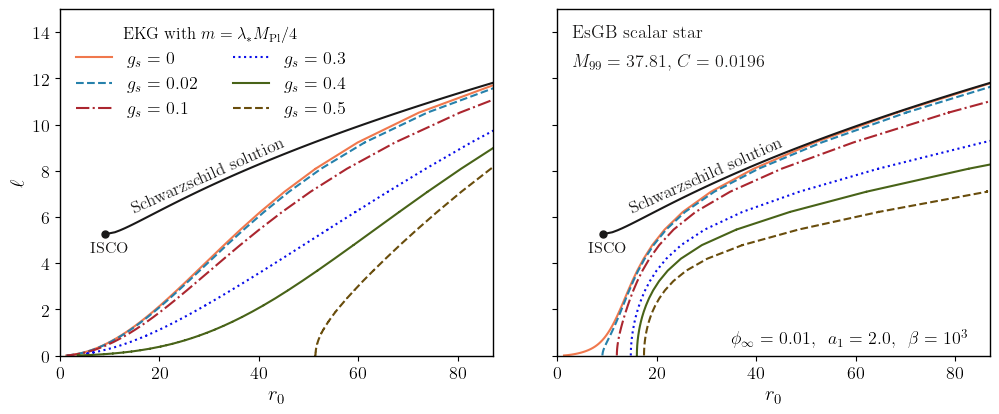

In [19]:
col = ['#1a1919', '#f0784d', '#2681ab', '#ab262f', "#090de9", '#486318', '#694d0c']
lineSt = ['-', '--', '-.', ':', '-', '--', '-.']  # Different line styles for each gs value

M = eq.masaADMProf(rspan, sol[1])[-1]
rlim = 6*M
vllim = np.sqrt(2.*M/3.) * rlim/np.sqrt(-4*M+ rlim)
lval = np.logspace(np.log10(np.round(vllim, 4)), np.log10(np.round(vllim, 3) + 8), 60)
scRL = lambda l, M: (l**2 - np.sqrt(l**4 - 12 * l**2 * M**2))/(2*M)
scRL2 = lambda l, M: (l**2 + np.sqrt(l**4 - 12 * l**2 * M**2))/(2*M)

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(12, 4.5),
                       sharex=False, sharey=True,
                       gridspec_kw=dict(hspace=0.1, wspace=.15))
marker_styles = ['o', '*', 's', 'v', 's', 'v']  # Different markers for each gs value
for ind, raizvalor in enumerate(DataGBstar):
    ax[1].plot(raizvalor[1], raizvalor[2], ls=lineSt[ind], color=col[ind+1], alpha=1, label=f'$g_s={raizvalor[0]}$')
#    for i in range(len(raizvalor)):
#        ax[1].plot(raizvalor[i, 0], raizvalor[i, 1], ls='', color='b' if raizddVeff[ind][i, 0]>0 else 'orange',
#            marker=marker_styles[ind], markersize=4, mfc='white')

for ind, raizvalor in enumerate(DataEKG):
    ax[0].plot(raizvalor[1], raizvalor[2], ls=lineSt[ind], color=col[ind+1], alpha=1, label=f'$g_s={raizvalor[0]}$')
    #for i in range(len(raizvalor[1])):
    #    ax[0].plot(raizvalor[1][i], raizvalor[2][i], ls='', color='b' if raizvalor[3][i]>0 else 'orange',
    #        marker=marker_styles[ind], markersize=4, mfc='white')
        

for ind in range(2):
    # ax[ind].plot(scRL(lval, M), lval, ls='-.', c='orange', label='Raiz')
    ax[ind].plot(scRL2(lval, M), lval, ls='-', c=col[0]) # , label=r'Sch. solution'
    ax[ind].text(14, 7.8, r'Schwarzschild solution', rotation=24,
             fontsize=12.5, color=col[0], ha='left', va='center')
    ax[ind].plot(scRL2(lval, M)[0], lval[0], ls='', marker='o', markersize=5, c=col[0])
    ax[ind].text(scRL2(lval, M)[0]-3, lval[0]-0.6, s=r'ISCO', fontsize=11.5, color=col[0], ha='left', va='center')
    # ax[ind].vlines(3*M, ymin=0, ymax=100, ls=':', lw=1, color='k', alpha=0.3)
    # ax[ind].vlines(6*M, ymin=0, ymax=100, ls='--', lw=1, color='k', alpha=0.3)
    ax[ind].set_xlim(0, 87)
    ax[ind].set_ylim(0, 15)
    ax[ind].set_xlabel(r'$r_0$')
ax[0].set_ylabel(r'$\ell$')

ax[1].text(3, 14, r'$\mathrm{EsGB}$ scalar star', fontsize=13, color=col[0], ha='left', va='center')
ax[1].text(3, 12.5, r'$M_{99}=%3.2f$, $C=%5.4f$'%(M99, M99 / (8 * np.pi * R99)), fontsize=13, color=col[0])
#ax[1].text(75, 1, r'$\lambda_{*}=2$', fontsize=13, color=col[0])
ax[1].text(35, 0.5, s=r"$\phi_{\infty}=%3.2f, \;\; a_1=%2.1f, \;\; \beta=10^3$"%(a0, a1), fontsize=13)

ax[0].legend(loc='best', fontsize=13, ncols=2, frameon=False, title=r'$\mathrm{EKG}$ with $m=\lambda_{*} M_{\mathrm{Pl}}/4$',
             title_fontsize=12)

In [20]:
fig.savefig('ISCOS.pdf', format='pdf', metadata=None, # dpi='figure',
        pad_inches=0.1,
        facecolor='auto', edgecolor='auto',
        backend=None, dpi=1000, 
        bbox_inches='tight'# Plot will be occupy a maximum of available space # bbox_inches=None,
       )

In [304]:
scRL2(lval, M)

array([  9.11914032,  11.05221131,  12.0912217 ,  13.00739765,
        13.87278134,  14.71506465,  15.54849612,  16.38166912,
        17.22034186,  18.06868385,  18.92990338,  19.80659416,
        20.70094077,  21.61484729,  22.55002164,  23.50803284,
        24.49035139,  25.49837829,  26.53346668,  27.59693813,
        28.6900954 ,  29.81423239,  30.97064227,  32.16062406,
        33.38548824,  34.64656143,  35.94519049,  37.28274617,
        38.66062625,  40.08025858,  41.54310371,  43.05065744,
        44.60445324,  46.20606454,  47.8571069 ,  49.55924024,
        51.31417091,  53.12365384,  54.9894946 ,  56.91355152,
        58.89773778,  60.94402354,  63.05443812,  65.23107214,
        67.47607977,  69.79168101,  72.18016394,  74.64388718,
        77.18528223,  79.80685598,  82.5111933 ,  85.30095956,
        88.17890343,  91.14785952,  94.21075134,  97.37059414,
       100.63049792, 103.99367058, 107.46342106, 111.04316263])